In [1]:
import pandas as pd
import os
from helper import plot_sample_images, plot_sample_images_multi
from util import convert_to_yolov5
import numpy as np

800-352-2255
If they have Tracking info from PNC: 

If they send it over mail: 
    
    
Payoff Info overnight:
PNC Payoff Lock BOX 645993 500 1st ave Pitsburg PA 15219


Payoff Regular:
PNC Payoff PO BOX 645993 Pitsburg PA 15274-5993

They have not received the payment 

In [2]:
df_train, df_test = pd.read_csv('./Train.csv'), pd.read_csv('./Test.csv')
print(f"Training Data Shape:  {df_train.shape}\nTest Data Shape:      {df_test.shape}")

Training Data Shape:  (3906, 6)
Test Data Shape:      (931, 1)


In [3]:
df_train.Image_ID.nunique()

3001

In [4]:
df_train[df_train['class'] == 'fruit_healthy'].Image_ID.unique()

array(['ID_00ZJEEK3', 'ID_05R05ZLJ', 'ID_06EXUMWA', ..., 'ID_ZZ5YBO5A',
       'ID_ZZAB1FH1', 'ID_ZZJZ2CV6'], dtype=object)

In [5]:
df_train['class'].value_counts()

fruit_healthy      1638
fruit_woodiness    1246
fruit_brownspot    1022
Name: class, dtype: int64

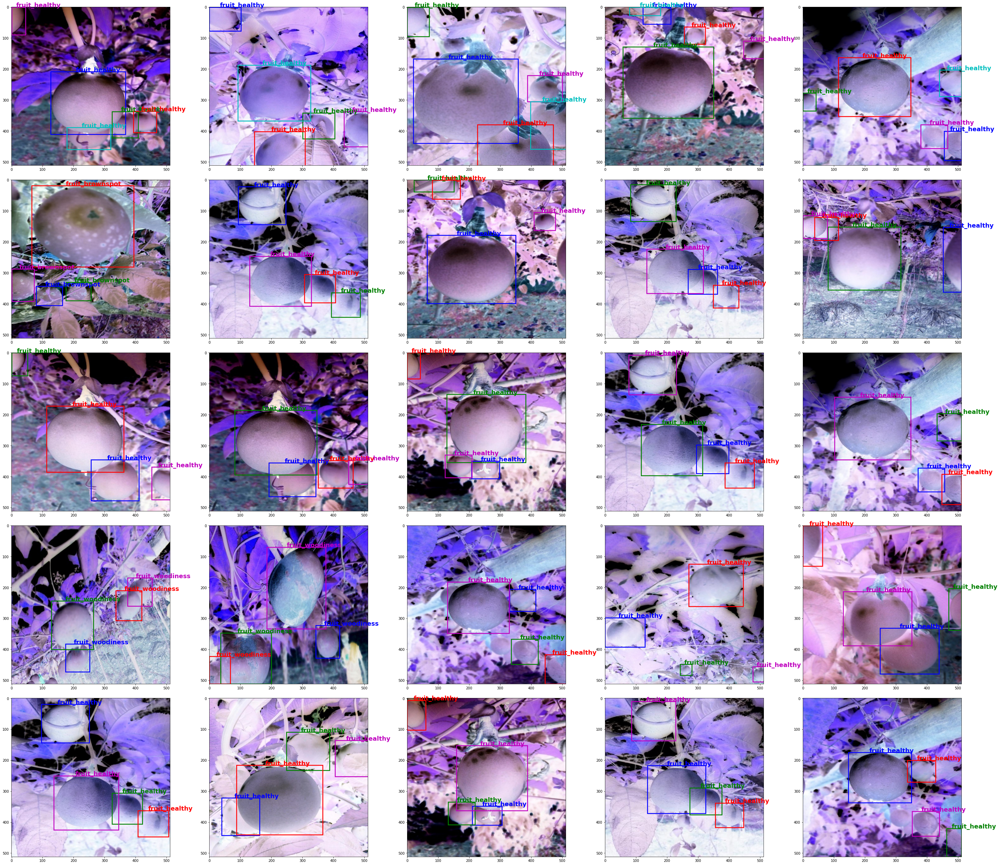

In [6]:
plot_sample_images_multi(df_train)

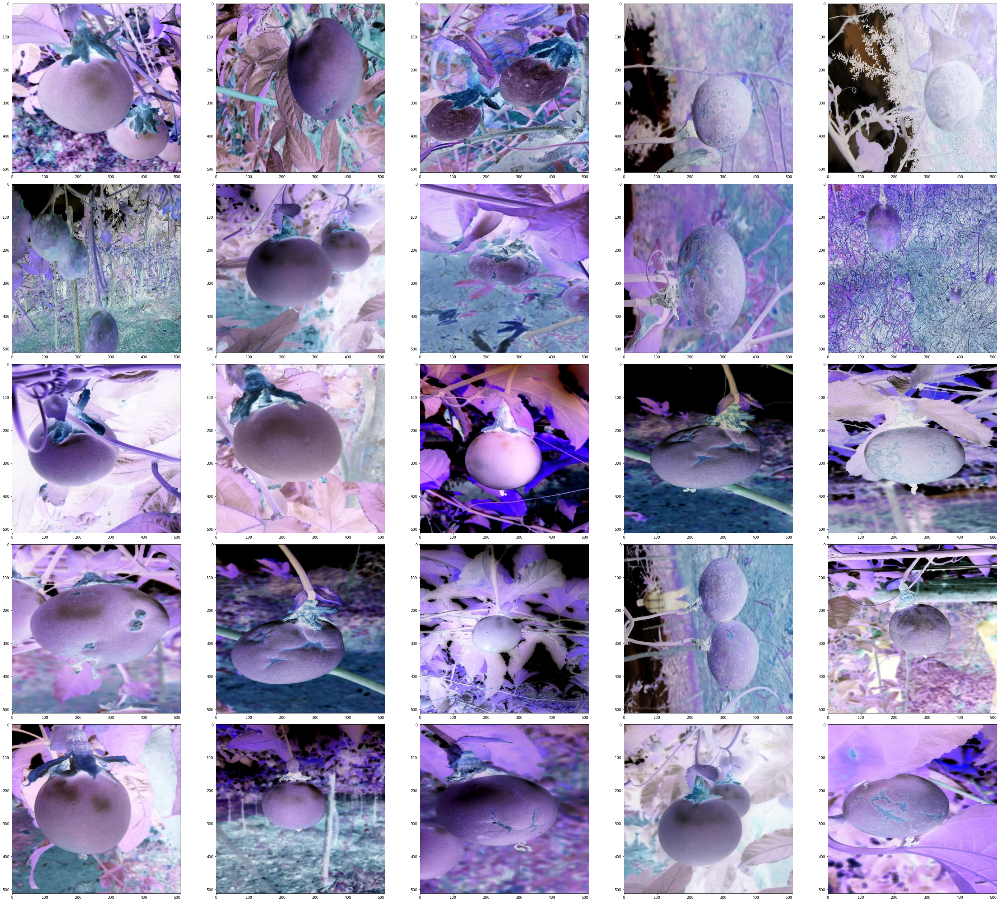

In [7]:
plot_sample_images_multi(df_test, show_label=False, is_train=False)

In [8]:
class_dic = {
    'fruit_healthy':0,
    'fruit_woodiness':1,
    'fruit_brownspot':2
}
df_train['class_ints'] = df_train['class']
df_train['class_ints']=df_train['class_ints'].apply(lambda x: class_dic.get(x))

In [12]:
df_train

,Image_ID,class,xmin,ymin,width,height,class_ints,x_center,y_center,label
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422,1,0.392578,0.474609,1
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383,2,0.429688,0.380371,2
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820,2,0.547852,0.704590,2
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828,0,0.492676,0.588867,0
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469,2,0.383301,0.631836,2
...,...,...,...,...,...,...,...,...,...,...
3901,ID_ZZAB1FH1,fruit_healthy,0.187500,0.342773,0.565430,0.433594,0,0.470215,0.559570,0
3902,ID_ZZAB1FH1,fruit_healthy,0.644531,0.470703,0.355469,0.352539,0,0.822266,0.646973,0
3903,ID_ZZJZ2CV6,fruit_healthy,0.699219,0.457031,0.262695,0.208984,0,0.830566,0.561523,0
3904,ID_ZZJZ2CV6,fruit_healthy,0.192383,0.263672,0.538086,0.416992,0,0.461426,0.472168,0


In [9]:
regenerate_labels = True
if regenerate_labels:
    convert_to_yolov5(df_train)

100%|██████████████████████████████████████| 3001/3001 [00:03<00:00, 793.72it/s]


In [23]:
regenerate_train_val_split = False
if regenerate_train_val_split:
    np.random.seed(123)
    arrays = []
    for class_name in df_train['class'].unique():
        arrays.append(np.random.choice(df_train[df_train['class'] == class_name].Image_ID.unique(), 108))
    test_set_files = np.unique(np.concatenate(arrays))

    for file in test_set_files:
        print(f"Moving {file}....")
        os.rename(f"./Train_Images/{file}.jpg", f"./Val_Images/{file}.jpg")
        os.rename(f"./yolo5Input/{file}.txt", f"./Val_Labels/{file}.txt")

In [10]:
IMG_HEIGHT = 512
IMG_WIDTH = 512

In [11]:
df_train.head()

,Image_ID,class,xmin,ymin,width,height,class_ints,x_center,y_center,label
0,ID_007FAIEI,fruit_woodiness,0.169922,0.170898,0.445312,0.607422,1,0.392578,0.474609,1
1,ID_00G8K1V3,fruit_brownspot,0.190430,0.034180,0.478516,0.692383,2,0.429688,0.380371,2
2,ID_00WROUT9,fruit_brownspot,0.305664,0.409180,0.484375,0.590820,2,0.547852,0.704590,2
3,ID_00ZJEEK3,fruit_healthy,0.244141,0.376953,0.497070,0.423828,0,0.492676,0.588867,0
4,ID_018UIENR,fruit_brownspot,0.155273,0.454102,0.456055,0.355469,2,0.383301,0.631836,2


In [18]:
%cd ./datasets/Train/

/home/bdina/Desktop/jhu_dnn/Passion-Fruit-Disease-Detection/Experiments/datasets/Train


In [19]:
from pathlib import Path
Path("labels").mkdir(parents=True, exist_ok=True)

In [13]:
for img_name in df_train['Image_ID'].unique():

  # grab rows with this id
  df_train_yolo5 = df_train[df_train['Image_ID'] == img_name]
  # keep only the columsn that yolo 5 needs
  df_train_yolo5 = df_train_yolo5[['class_ints','x_center','y_center','width','height']]
  # write to txt file via to_csv
  # https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_csv.html
  # https://stackoverflow.com/questions/16923281/writing-a-pandas-dataframe-to-csv-file
  # https://stackoverflow.com/questions/31247198/python-pandas-write-content-of-dataframe-into-text-file
  df_train_yolo5.to_csv(f'{img_name}.txt', encoding='utf-8',header=False, index=False, sep=' ', mode='a')


In [29]:
df_train_yolo5

,class,x_center,y_center,width,height
3905,fruit_woodiness,0.434082,0.57666,0.385742,0.299805
